In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
import joblib
import cleaning

In [2]:
import sys
print(sys.executable)

/bsuhome/yavarpourmohamad/miniforge3/envs/ML/bin/python


# Load FPA FOD with all causes

In [3]:
nwcg = pd.read_csv(filepath_or_buffer = '/bsuhome/yavarpourmohamad/scratch/Dissertation/Code/Karen_email/NWCG_UnitIdActive_20200123.csv', sep = ',')

In [4]:
cols_FPA = ['DISCOVERY_DOY', 'LATITUDE', 'FIRE_YEAR', 'LONGITUDE', 'FIPS_CODE', 'Annual_etr', 'Annual_precipitation', 'NWCG_GENERAL_CAUSE',
            'Annual_tempreture', 'pr', 'tmmn', 'vs', 'fm100', 'fm1000', 'bi', 'vpd', 'erc', 'Elevation_1km', 'Aspect_1km', 'erc_Percentile', 'Slope_1km',
            'TPI_1km', 'EVC', 'FRG', 'Mang_Name', 'GAP_Sts', 'GDP', 'GHM', 'NPL',
            'Popo_1km']
cause_dic =  {'Debris and open burning': 'Debris',
              'Arson/incendiarism': 'Arson',
              'Recreation and ceremony': 'Recreation',
              'Missing data/not specified/undetermined': 'Missing',
              'Equipment and vehicle use': 'Equipment',
              'Power generation/transmission/distribution': 'Power',
              'Misuse of fire by a minor': 'Misuse by minor',
              'Firearms and explosives use': 'Firearms',
              'Railroad operations and maintenance': 'Railroad'}

selected_fires = pd.read_csv(filepath_or_buffer='/bsuhome/yavarpourmohamad/scratch/Dissertation/Cause_specific/Mapping/sel_fires.csv',
                             sep=',')
fire_names = ['POWERLINES', 'JULY 3RD', 'SAWMILL', 'UPRRMM326', 'NIGHT DITCH', 'WAMIC MARKET', 'BRAD BERRY', 'D2 CAMPFIRE # 3', 'STONE', 'WILLOW CRK', 'SHADY FIRE']
selected_fires = selected_fires[selected_fires['FIRE_NAME'].isin(fire_names)]

In [5]:
labels = {'USFS': 0,
        'BLM': 1,
        'UNK': 2,
        'TRIB': 3,
        'SLB': 4,
        'SFW': 5,
        'SPR': 6,
        'SDOL': 7,
        'SDNR': 8,
        'REG': 9,
        'CITY': 10,
        'NPS': 11,
        'PVT': 12,
        'NGO': 13,
        'FWS': 14,
        'CNTY': 15,
        'USBR': 16,
        'DOD': 17,
        'UNKL': 18,
        'RWD': 19,
        'USACE': 20,
        'OTHS': 21,
        'NRCS': 22,
        'ARS': 23,
        'DOE': 24,
        'JNT': 25,
        'OTHF': 26,
        'OTHR': 27,
        'SDC': 28,
        'BPA': 29}
sts = ['WA', 'OR', 'CA', 'ID', 'NV', 'MT', 'WY', 'UT', 'AZ', 'CO', 'NM']

# 2019 Point dt and cleaning

In [5]:
map_dt = pd.read_csv(filepath_or_buffer = '/bsuhome/yavarpourmohamad/scratch/Dissertation/Code/Mapping/map_Dt_2019_1.csv',
                     sep = ',')
cols = ['index', 'LONGITUDE', 'LATITUDE', 'DISCOVERY_DOY', 'FIRE_YEAR',
        'FIPS_CODE', 'Annual_etr', 'Annual_precipitation', 'Annual_tempreture',
        'pr', 'tmmn', 'vs', 'fm100', 'fm1000', 'bi', 'vpd', 'erc', 'Elevation_1km',
        'Aspect_1km', 'erc_Percentile', 'Slope_1km', 'TPI_1km', 'EVC', 'FRG',
        'Mang_Name', 'GAP_Sts', 'GDP', 'GHM', 'NPL',
        'Popo_1km']
map_cln = map_dt[cols]
map_cln, cln_rslt = cleaning.cleaning(df = map_cln)
map_cln['Mang_Name'] = map_cln['Mang_Name'].replace(to_replace = labels)
map_cln[['Annual_etr', 'Annual_precipitation']] = map_cln[['Annual_etr', 'Annual_precipitation']].astype(int)
map_cln['Annual_tempreture'] = map_cln['Annual_tempreture'].round(0).astype(int)
map_cln['erc_Percentile'] = map_cln['erc_Percentile'].round(0).astype(int)
print(map_cln.shape)

/tmp/ipykernel_38871/3119452466.py:11: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  map_cln['Mang_Name'] = map_cln['Mang_Name'].replace(to_replace = labels)


(6148190, 30)


In [6]:
grid = gpd.read_file(filename = '/bsuhome/yavarpourmohamad/scratch/Dissertation/Data/grid_map_2019_1.shp')
grid = grid.to_crs('EPSG:4326')
states = gpd.read_file(filename = '/bsuhome/yavarpourmohamad/scratch/FPA_FOD_Paper/Grid_variable_map/States/cb_2018_us_state_500k.shp')
states = states.loc[states['STUSPS'].isin(sts)]

# Calculating the probability


 1 : Processing for Natural ignition source...


/tmp/ipykernel_38871/2741956040.py:39: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  report_df = pd.concat([report_df, report], ignore_index=True)



 2 : Processing for Debris ignition source...

 3 : Processing for Fireworks ignition source...

 4 : Processing for Arson ignition source...

 5 : Processing for Recreation ignition source...

 6 : Processing for Smoking ignition source...

 7 : Processing for Equipment ignition source...

 8 : Processing for Power ignition source...

 9 : Processing for Misuse by minor ignition source...

 10 : Processing for Firearms ignition source...

 11 : Processing for Railroad ignition source...


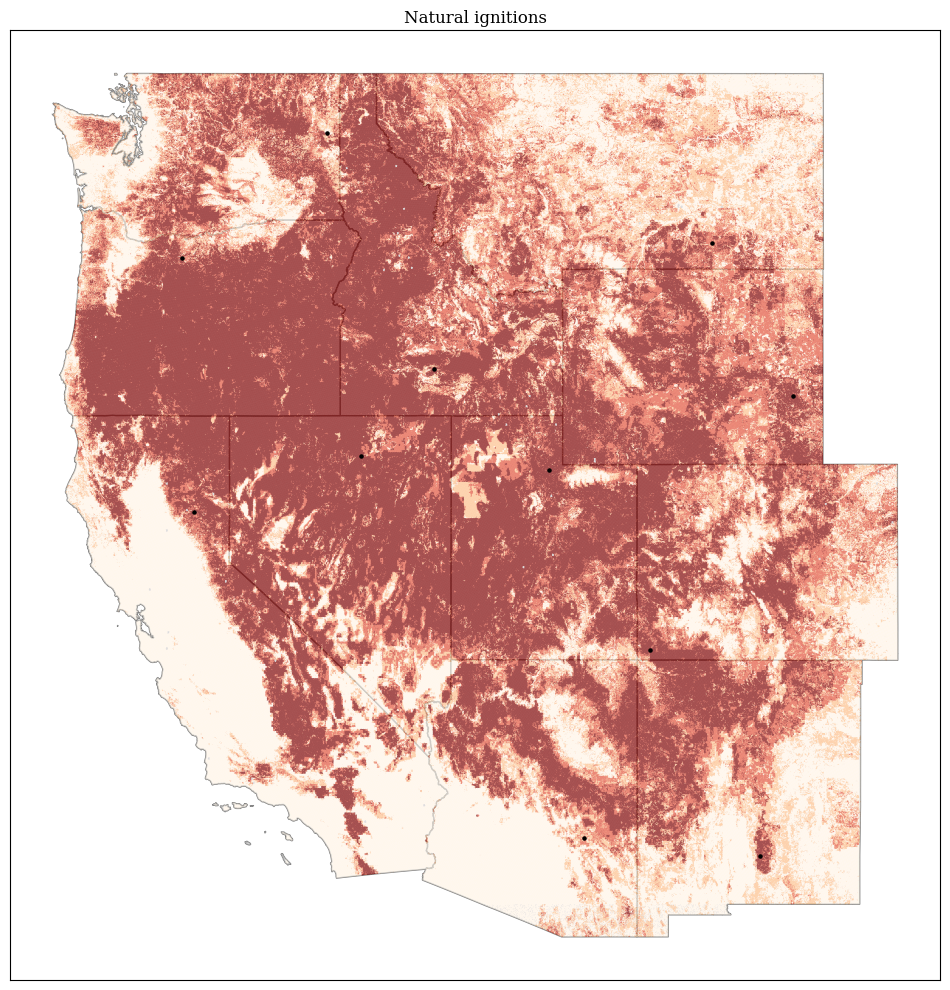

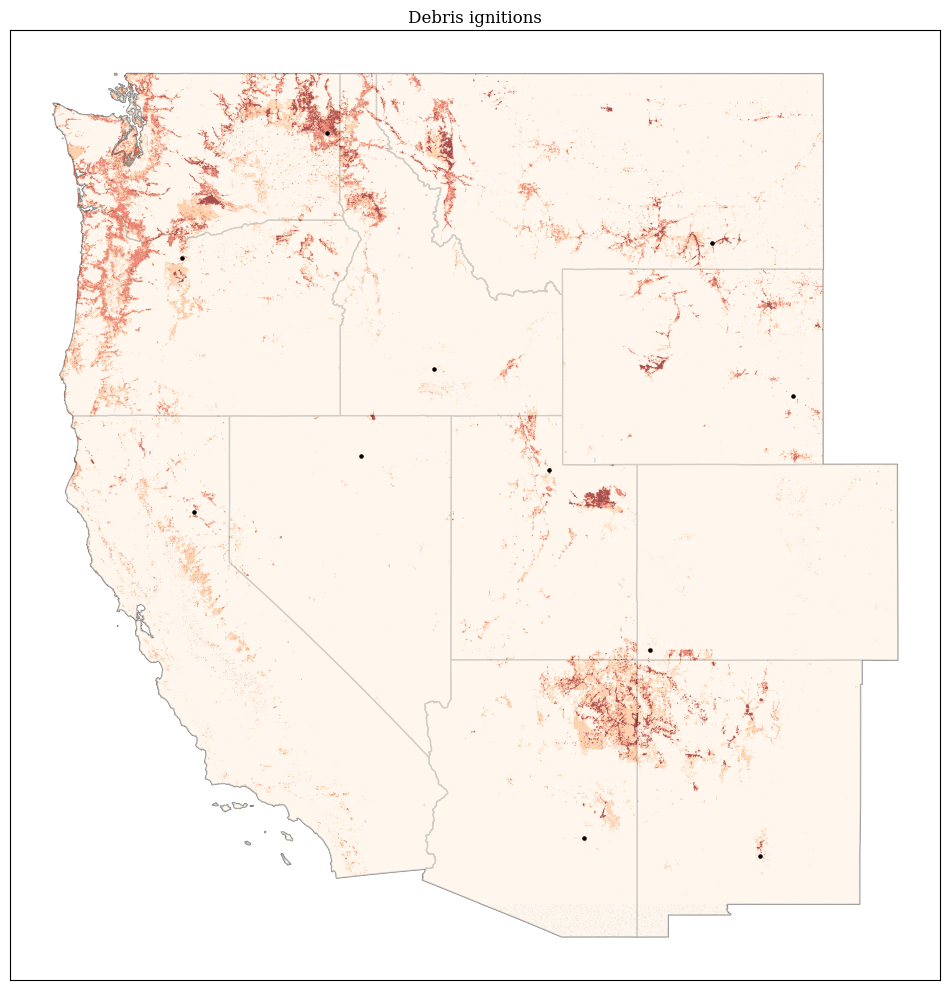

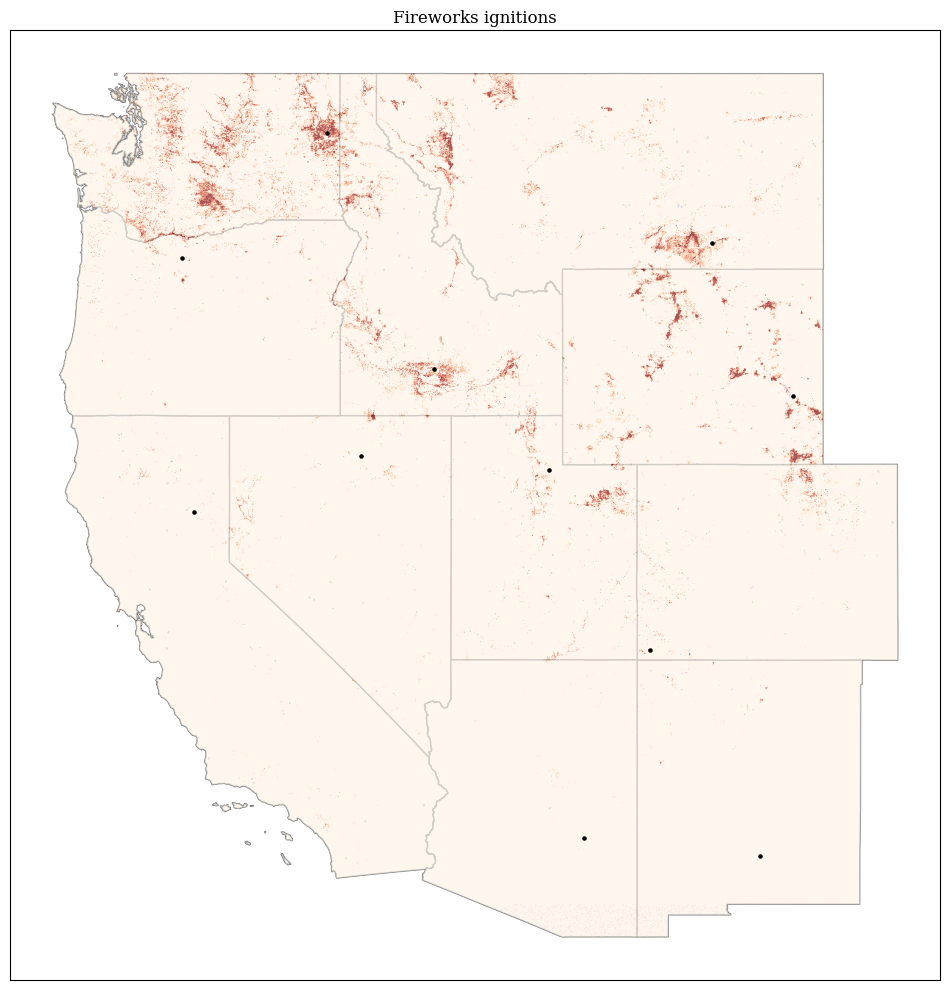

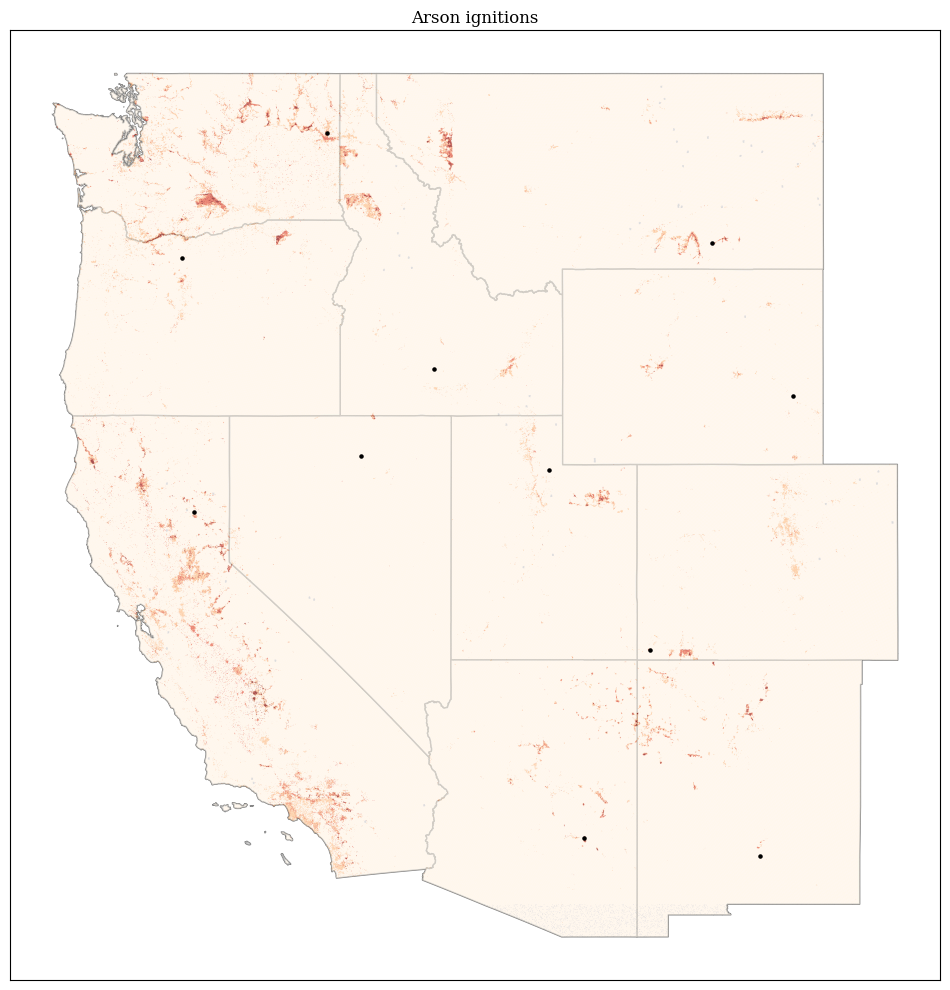

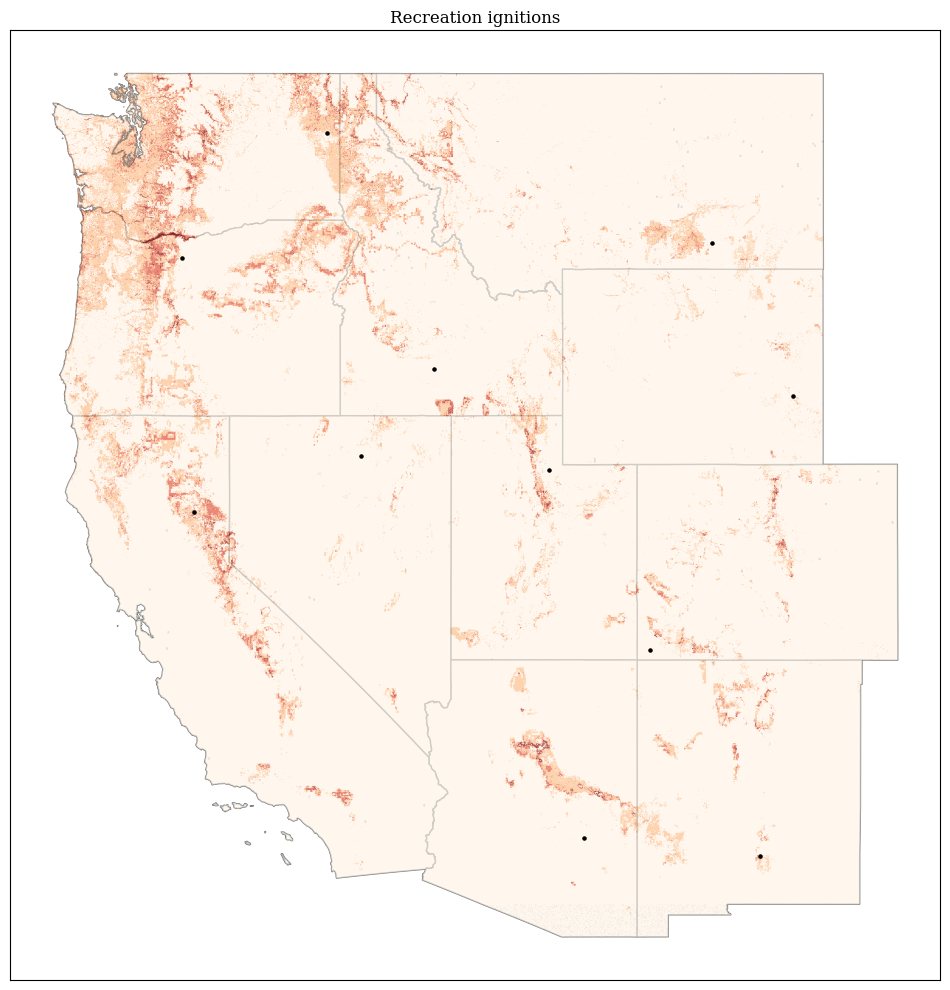

...

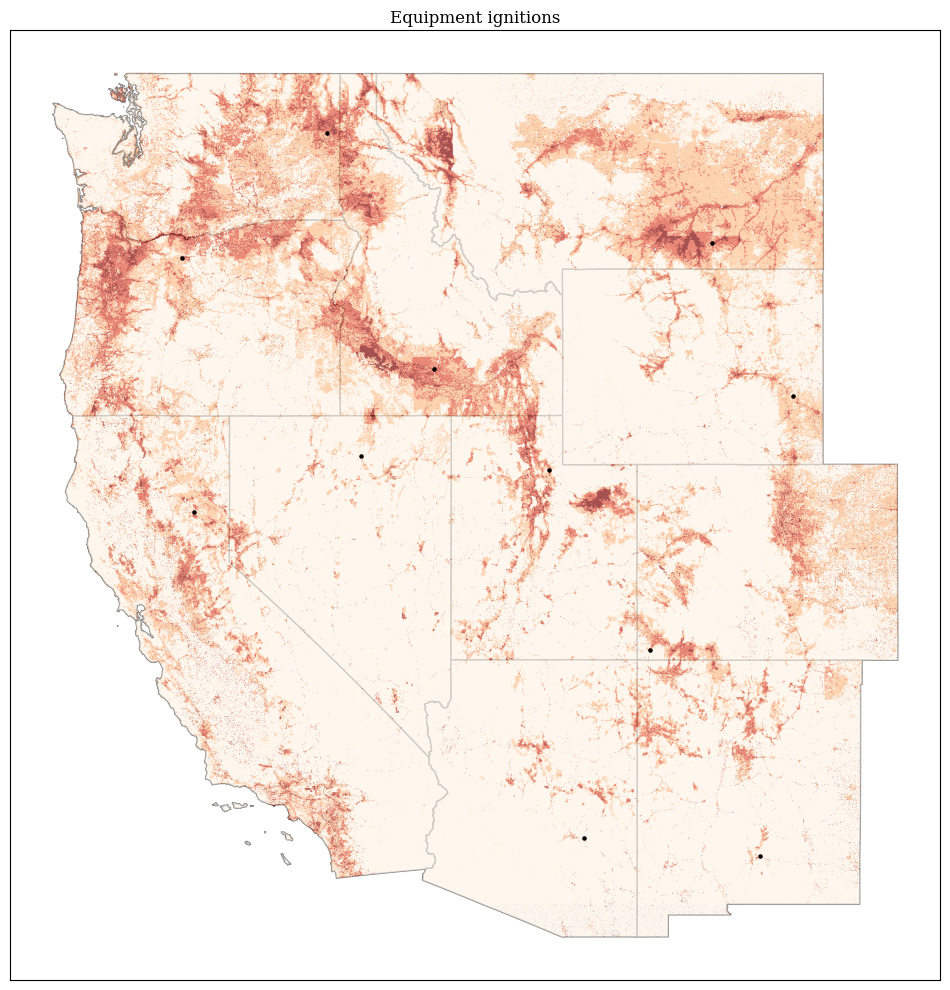

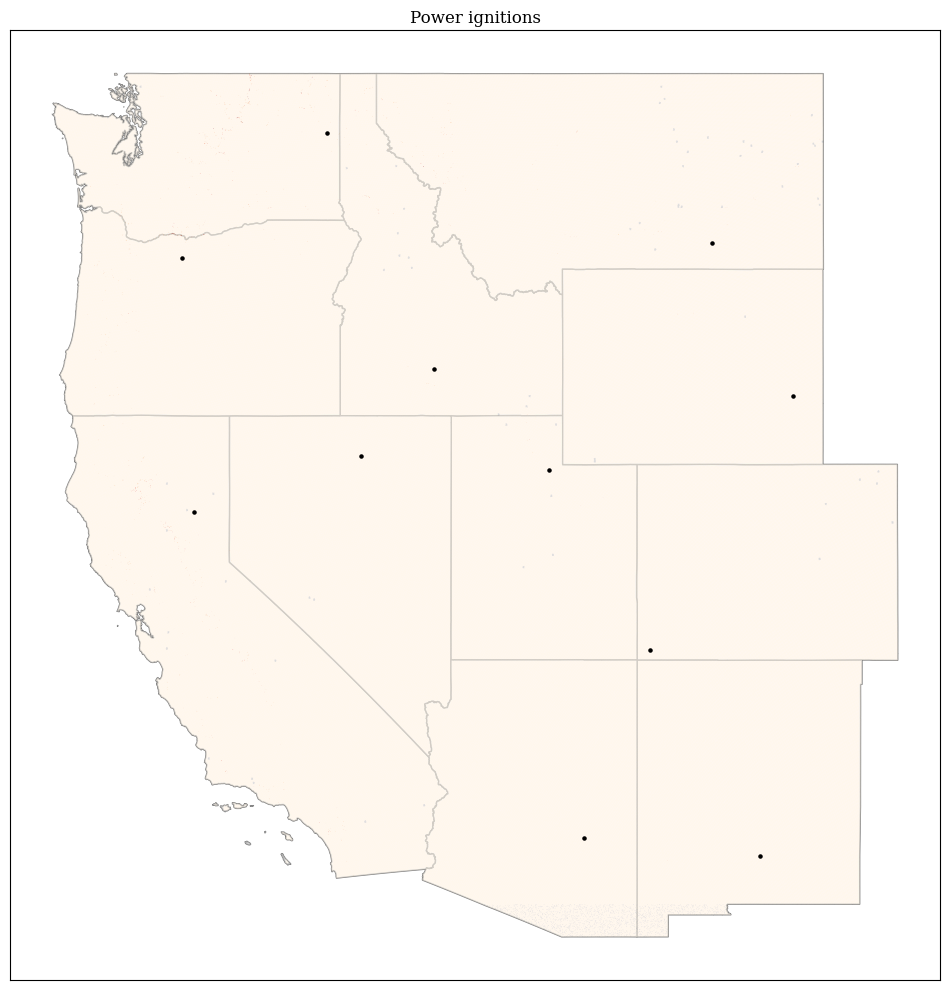

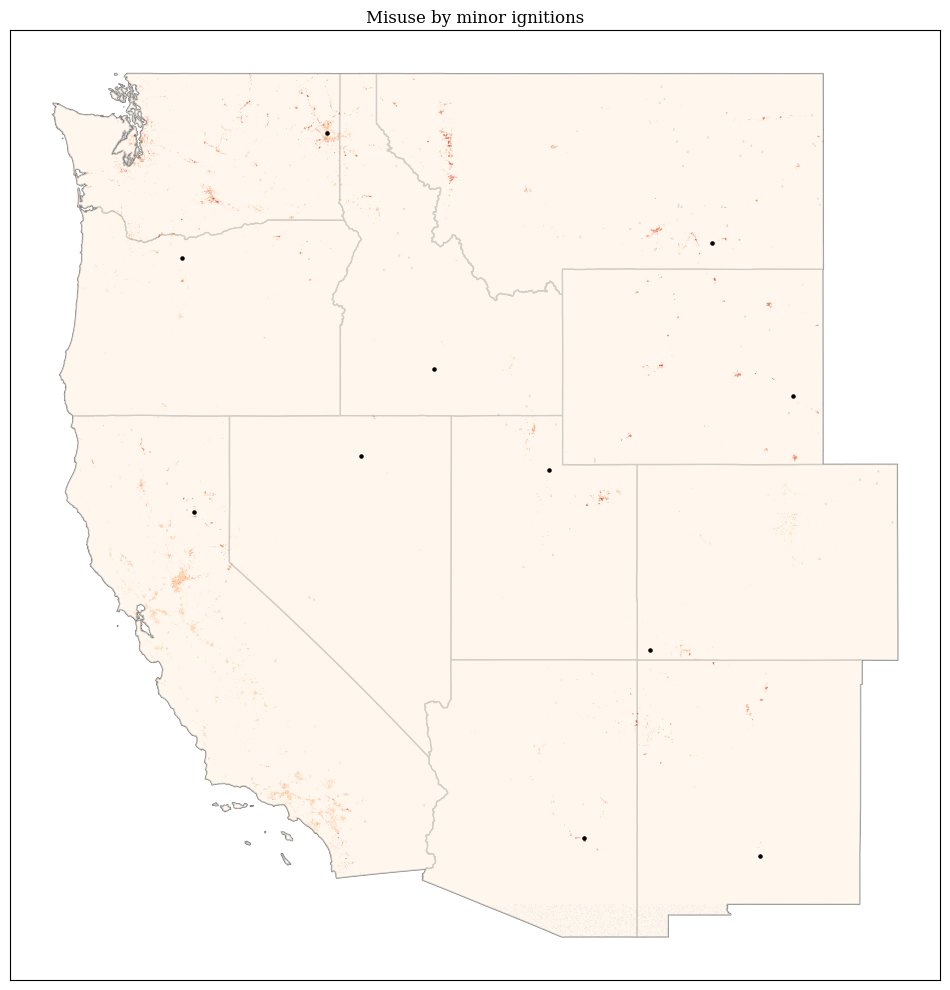

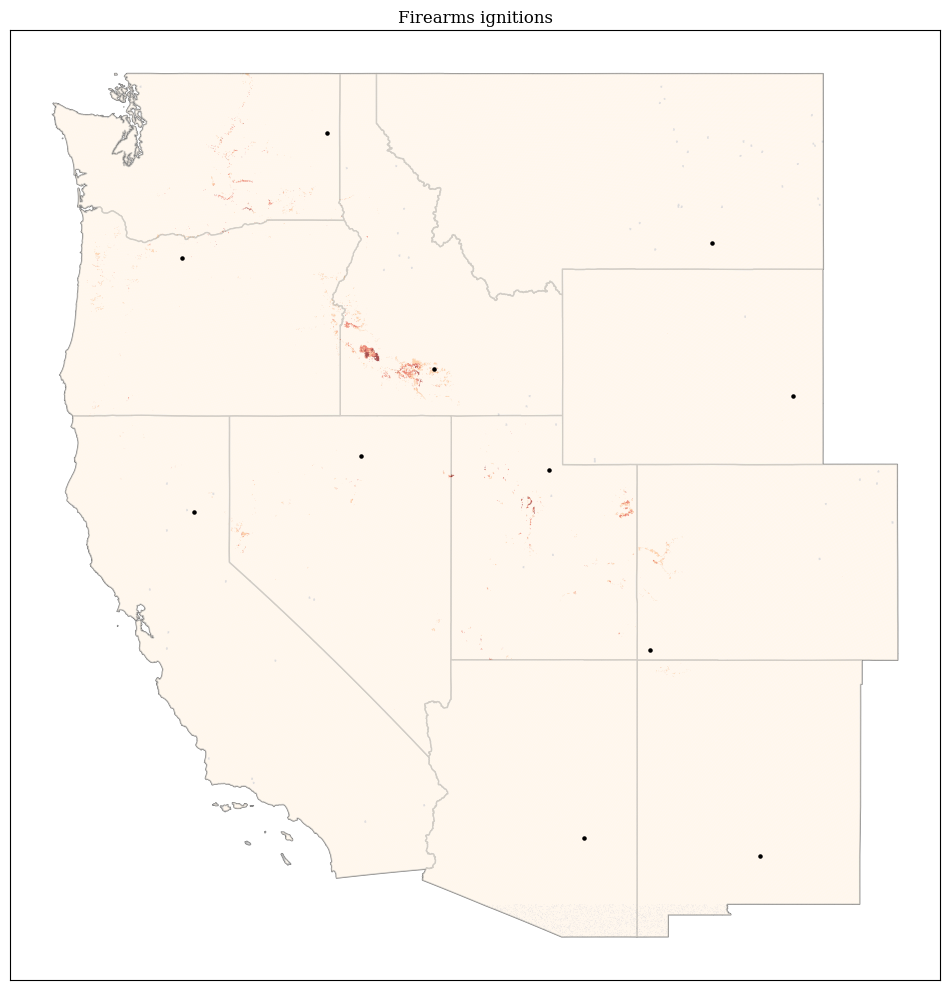

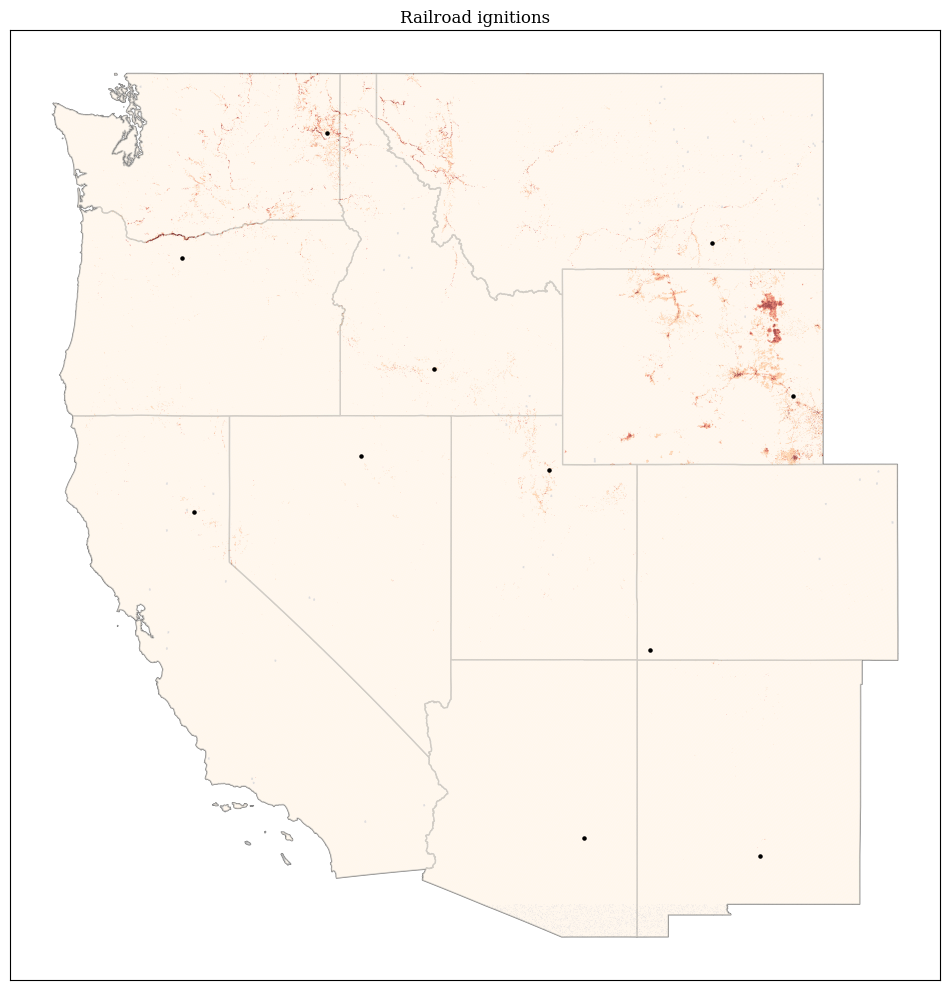

In [30]:
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman'] + plt.rcParams['font.serif']

causes =  ['Natural', 'Debris', 'Fireworks', 'Arson', 'Recreation', 'Smoking',
           'Equipment', 'Power', 'Misuse by minor', 'Firearms', 'Railroad']
report_df = pd.DataFrame(columns=['Ignition', 'Low (%)', 'Medium (%)', 'High (%)', 'Very high (%)', 'NA (%)'])
for i, cause in enumerate(iterable=causes):
    print('\n',i+1,': Processing for', cause, 'ignition source...')
    igni = joblib.load(filename=f'/bsuhome/yavarpourmohamad/scratch/Dissertation/Cause_specific/modeling/Final_models/{cause}_Ignition.pkl')
   
    y_igni_prob = igni.predict_proba(map_cln[map_cln.columns[3:]])

    prob_igni = pd.DataFrame(data = y_igni_prob, columns = ['No_fire', 'Fire'])

    map_dt = map_cln.copy(deep = True)
    map_dt['Fire'] = prob_igni['Fire'].to_numpy()
    # Adding fire points
    pnt_fire = selected_fires.copy(deep=True)
    pnt_fire = gpd.GeoDataFrame(data=pnt_fire,
                                crs='EPSG:4326',
                                geometry=gpd.points_from_xy(x=pnt_fire.LONGITUDE,
                                                            y=pnt_fire.LATITUDE))
    fire_days = dict()
    grid_days = dict()
    fig, axs = plt.subplots(nrows=1, ncols=1, sharey=False, figsize = (12, 30))
    doy = 248
    j = 0
    temp_grd = map_dt[map_dt['DISCOVERY_DOY'] == doy]
    temp_grd = pd.merge(left = grid, right = temp_grd, left_on = 'FID', right_on = 'index', how = 'left')

    na = ((len(temp_grd[temp_grd['Fire'] <= 0.25]) + len(temp_grd[(temp_grd['Fire'] > 0.25) & (temp_grd['Fire'] <= 0.5)]) + len(temp_grd[(temp_grd['Fire'] > 0.5) & (temp_grd['Fire'] <= 0.75)]) + len(temp_grd[temp_grd['Fire'] > 0.75])) * 100) / len(temp_grd)
    report = pd.DataFrame(data={'Ignition': [cause],
                                'Low (%)': [(len(temp_grd[temp_grd['Fire'] <= 0.25]) *100) / len(temp_grd)],
                                'Medium (%)': [(len(temp_grd[(temp_grd['Fire'] > 0.25) & (temp_grd['Fire'] <= 0.5)]) * 100) / len(temp_grd)],
                                'High (%)': [(len(temp_grd[(temp_grd['Fire'] > 0.5) & (temp_grd['Fire'] <= 0.75)]) * 100) / len(temp_grd)],
                                'Very high (%)': [(len(temp_grd[temp_grd['Fire'] > 0.75]) * 100) / len(temp_grd)],
                                'NA (%)': [100-na]
                                })
    report_df = pd.concat([report_df, report], ignore_index=True)

    # Ignition probability map plots section
    states.plot(ax = axs, edgecolor = 'grey', color = 'white')
    temp_grd.plot(column='Fire',
                  cmap='OrRd',
                  ax=axs,
                  legend=False,
                  missing_kwds={'color': 'lightgrey'},
                  scheme='equal_interval', # 'quantiles'
                  k=4)
    axs.tick_params(axis = 'both', which = 'both', length = 0)
    axs.set_xticklabels([])
    axs.set_yticklabels([])
    axs.set_title(f'{cause} ignitions')

    pnt_fire.plot(ax=axs, color='k', markersize=5)

# 2019 Point dt and cleaning

In [5]:
map_dt = pd.read_csv(filepath_or_buffer = '/bsuhome/yavarpourmohamad/scratch/Dissertation/Code/Mapping/map_Dt_2020_1.csv',
                     sep = ',')
cols = ['index', 'LONGITUDE', 'LATITUDE', 'DISCOVERY_DOY', 'FIRE_YEAR',
        'FIPS_CODE', 'Annual_etr', 'Annual_precipitation', 'Annual_tempreture',
        'pr', 'tmmn', 'vs', 'fm100', 'fm1000', 'bi', 'vpd', 'erc', 'Elevation_1km',
        'Aspect_1km', 'erc_Percentile', 'Slope_1km', 'TPI_1km', 'EVC', 'FRG',
        'Mang_Name', 'GAP_Sts', 'GDP', 'GHM', 'NPL',
        'Popo_1km']
map_cln = map_dt[cols]
map_cln, cln_rslt = cleaning.cleaning(df = map_cln)
map_cln['Mang_Name'] = map_cln['Mang_Name'].replace(to_replace = labels)
map_cln[['Annual_etr', 'Annual_precipitation']] = map_cln[['Annual_etr', 'Annual_precipitation']].astype(int)
map_cln['Annual_tempreture'] = map_cln['Annual_tempreture'].round(0).astype(int)
map_cln['erc_Percentile'] = map_cln['erc_Percentile'].round(0).astype(int)
print(map_cln.shape)

/tmp/ipykernel_28506/1257053151.py:11: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  map_cln['Mang_Name'] = map_cln['Mang_Name'].replace(to_replace = labels)


(6145885, 30)


In [6]:
grid = gpd.read_file(filename = '/bsuhome/yavarpourmohamad/scratch/Dissertation/Data/grid_map_2020_1.shp')
grid = grid.to_crs('EPSG:4326')
states = gpd.read_file(filename = '/bsuhome/yavarpourmohamad/scratch/FPA_FOD_Paper/Grid_variable_map/States/cb_2018_us_state_500k.shp')
states = states.loc[states['STUSPS'].isin(sts)]

# Calculating the probability


 1 : Processing for Natural ignition source...


/tmp/ipykernel_28506/3005529003.py:39: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  report_df = pd.concat([report_df, report], ignore_index=True)



 2 : Processing for Debris ignition source...

 3 : Processing for Fireworks ignition source...

 4 : Processing for Arson ignition source...

 5 : Processing for Recreation ignition source...

 6 : Processing for Smoking ignition source...

 7 : Processing for Equipment ignition source...

 8 : Processing for Power ignition source...

 9 : Processing for Misuse by minor ignition source...

 10 : Processing for Firearms ignition source...

 11 : Processing for Railroad ignition source...


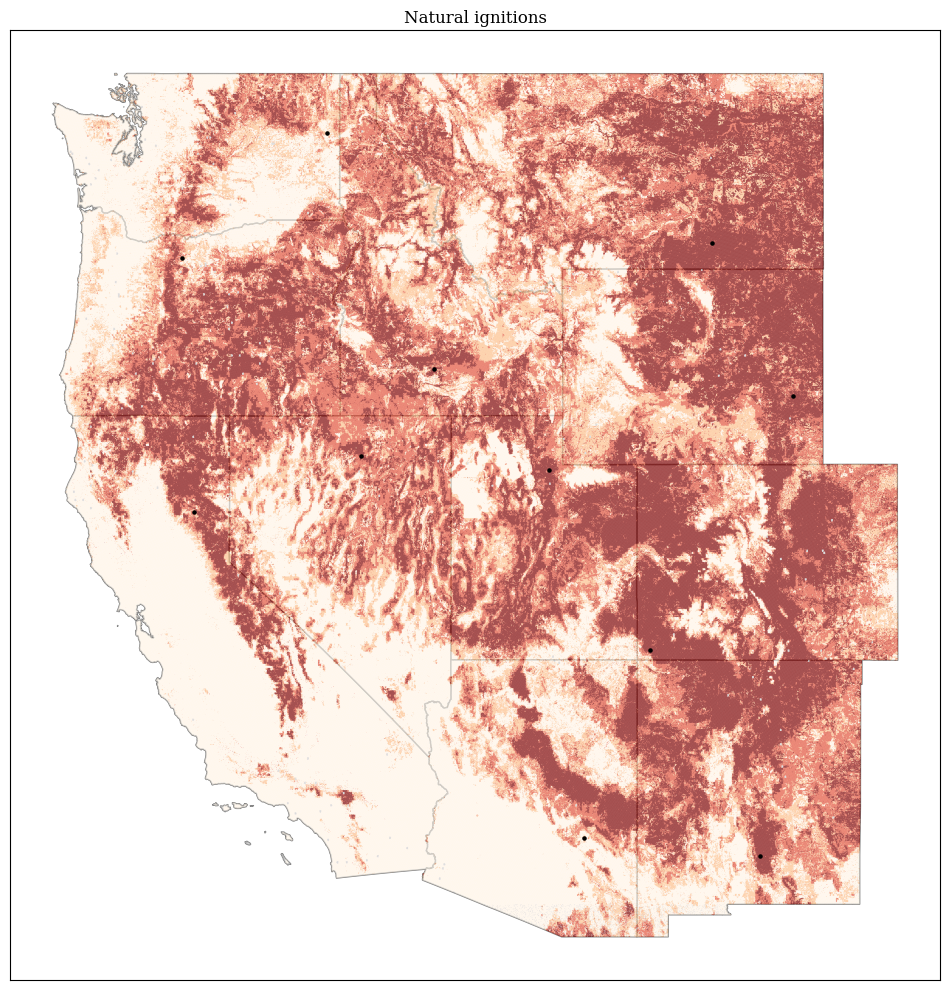

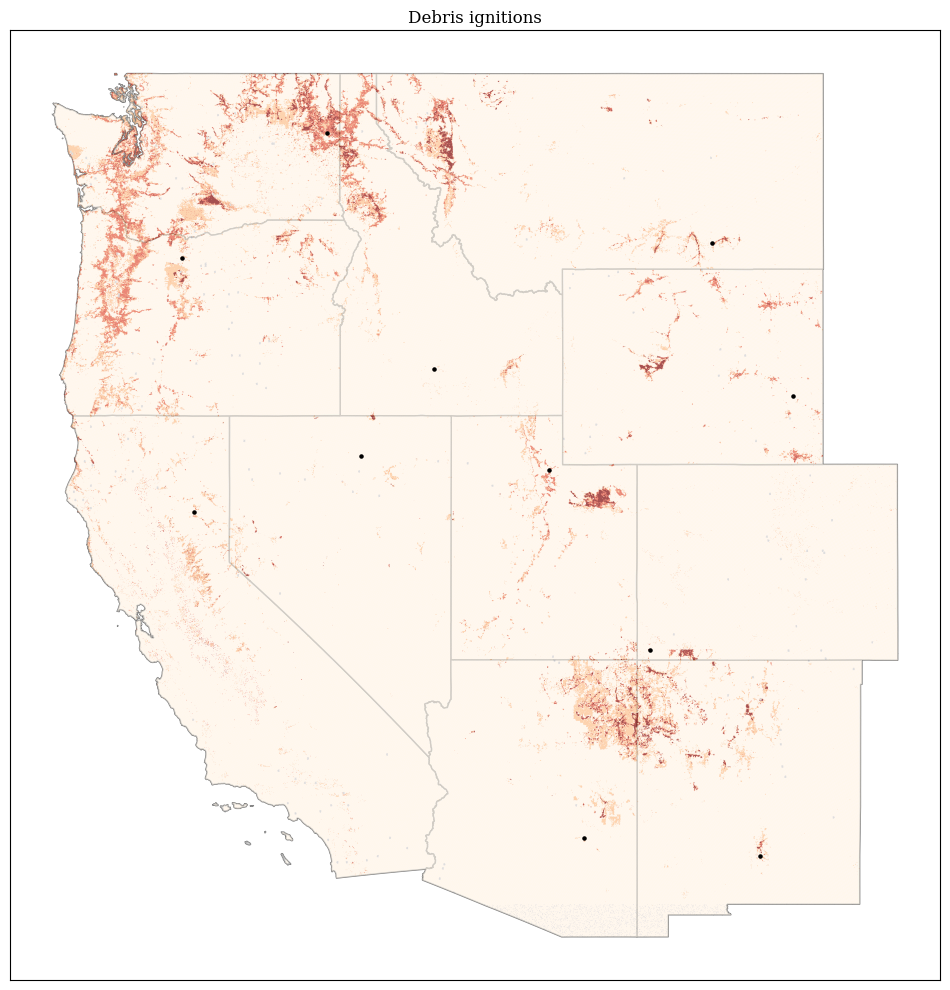

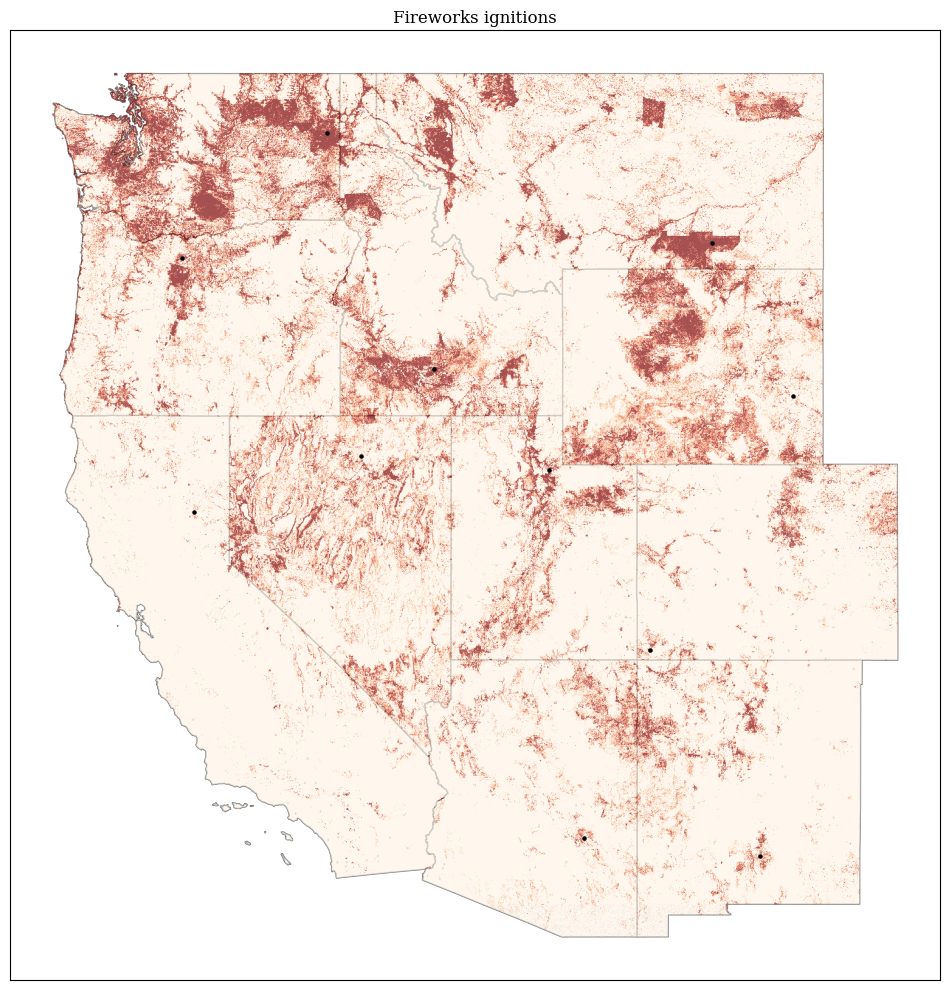

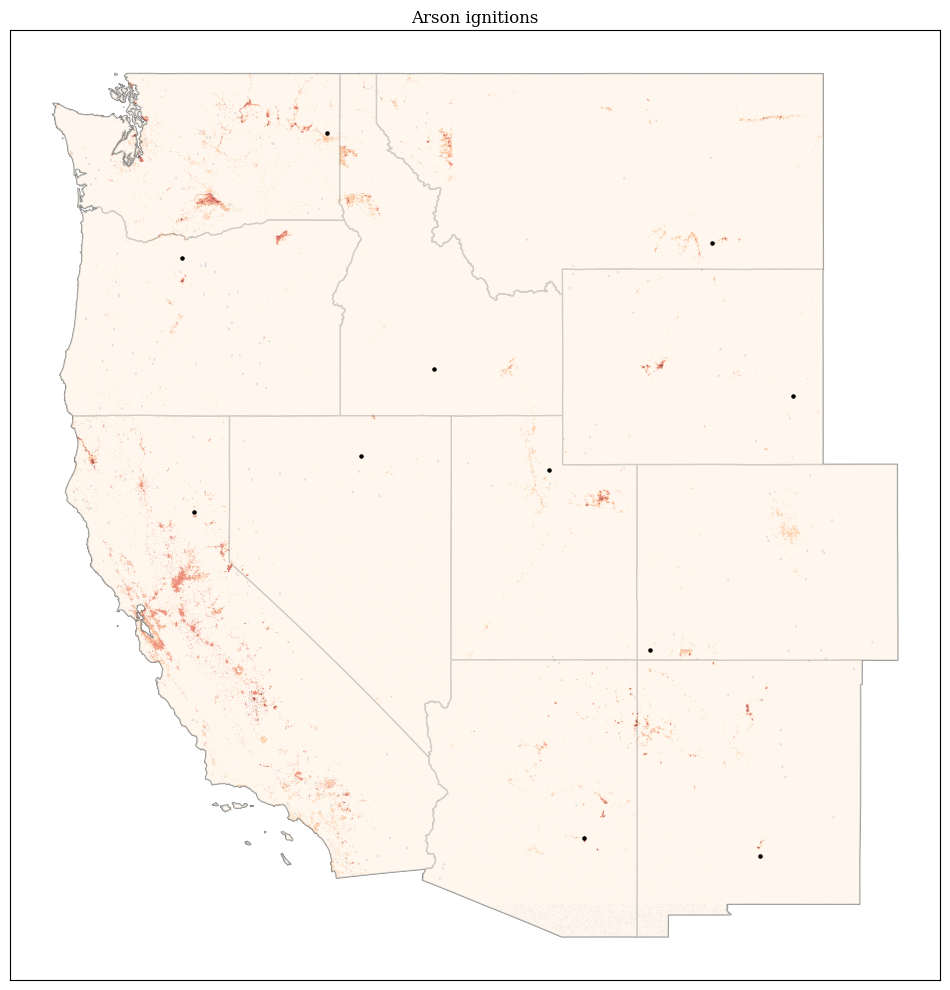

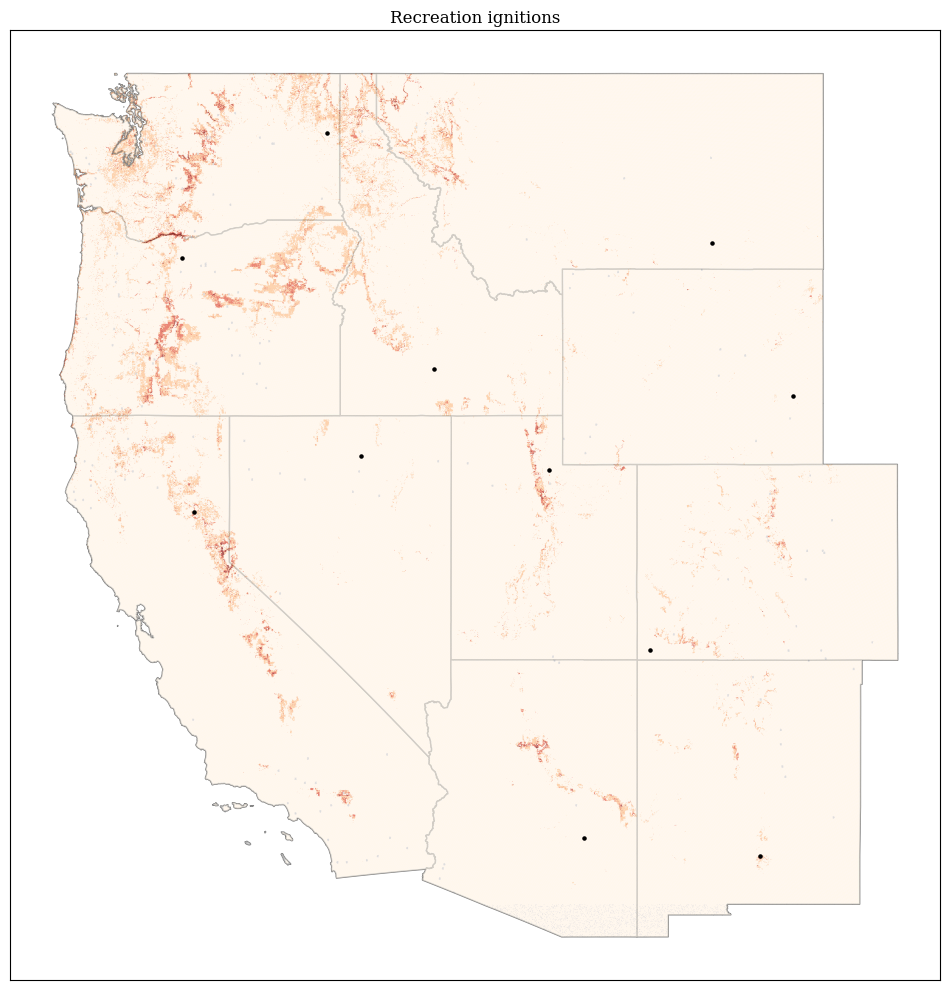

...

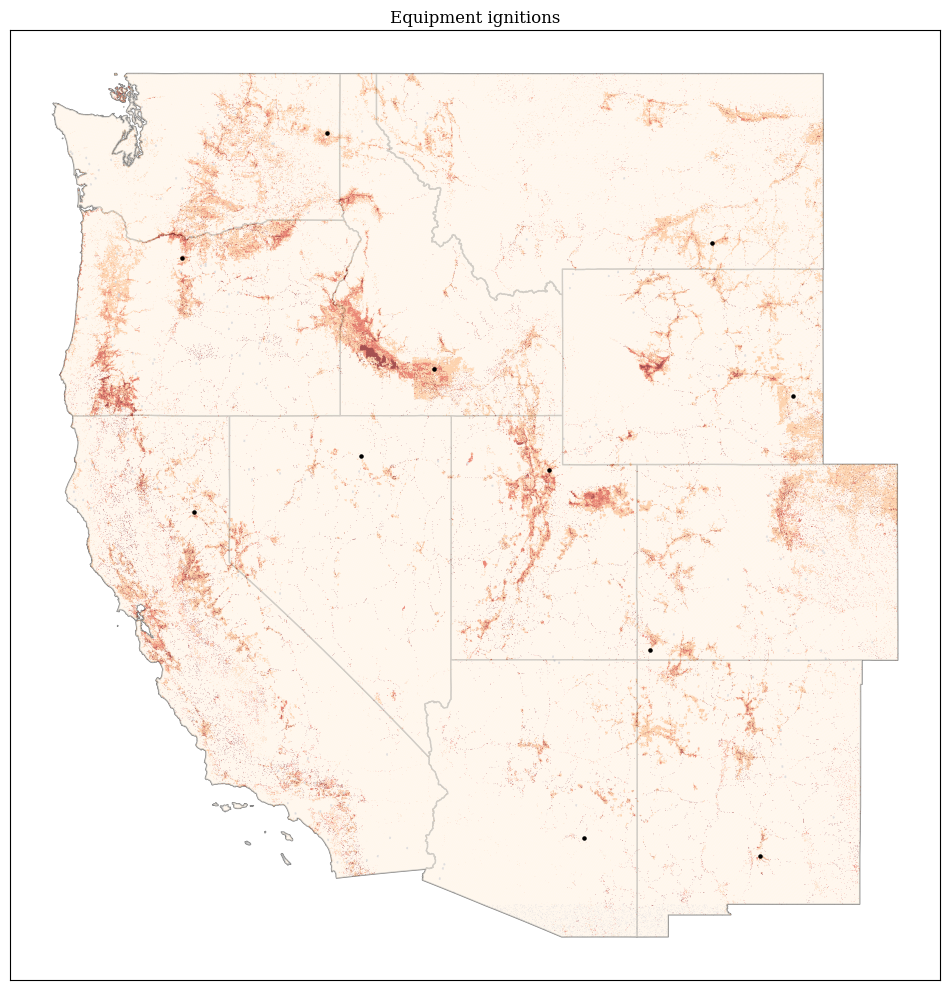

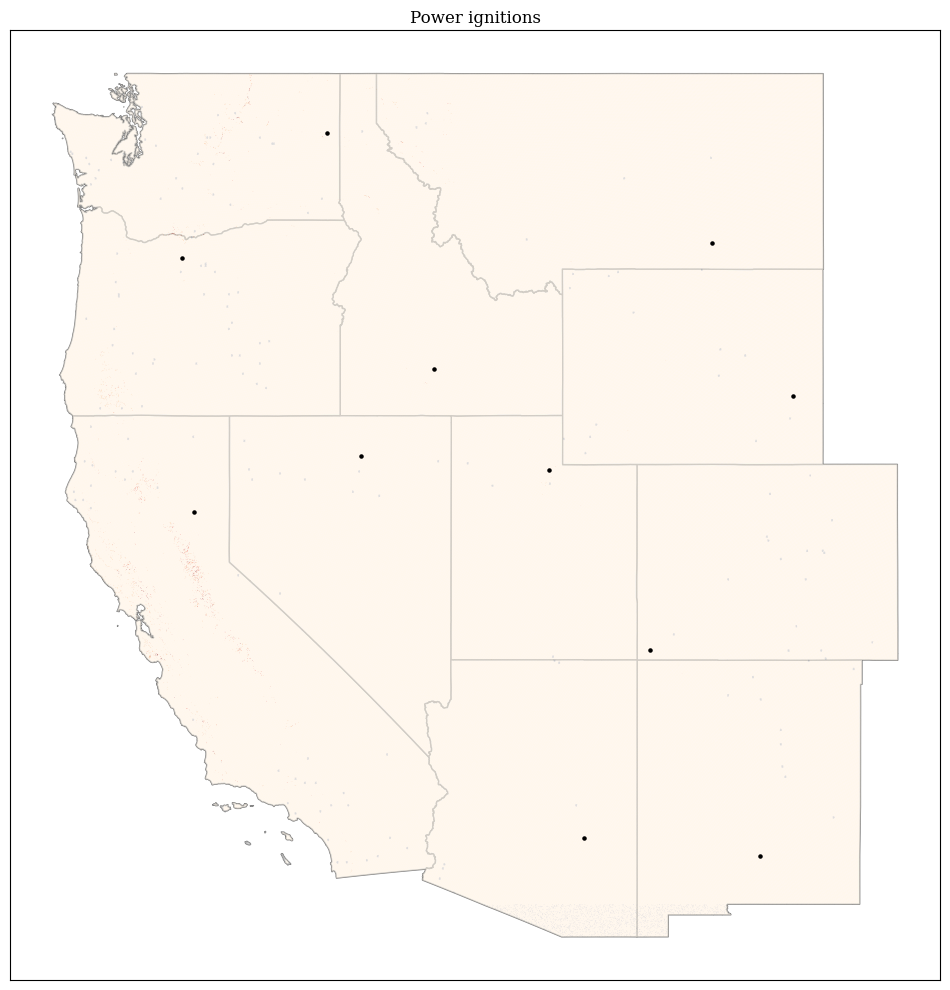

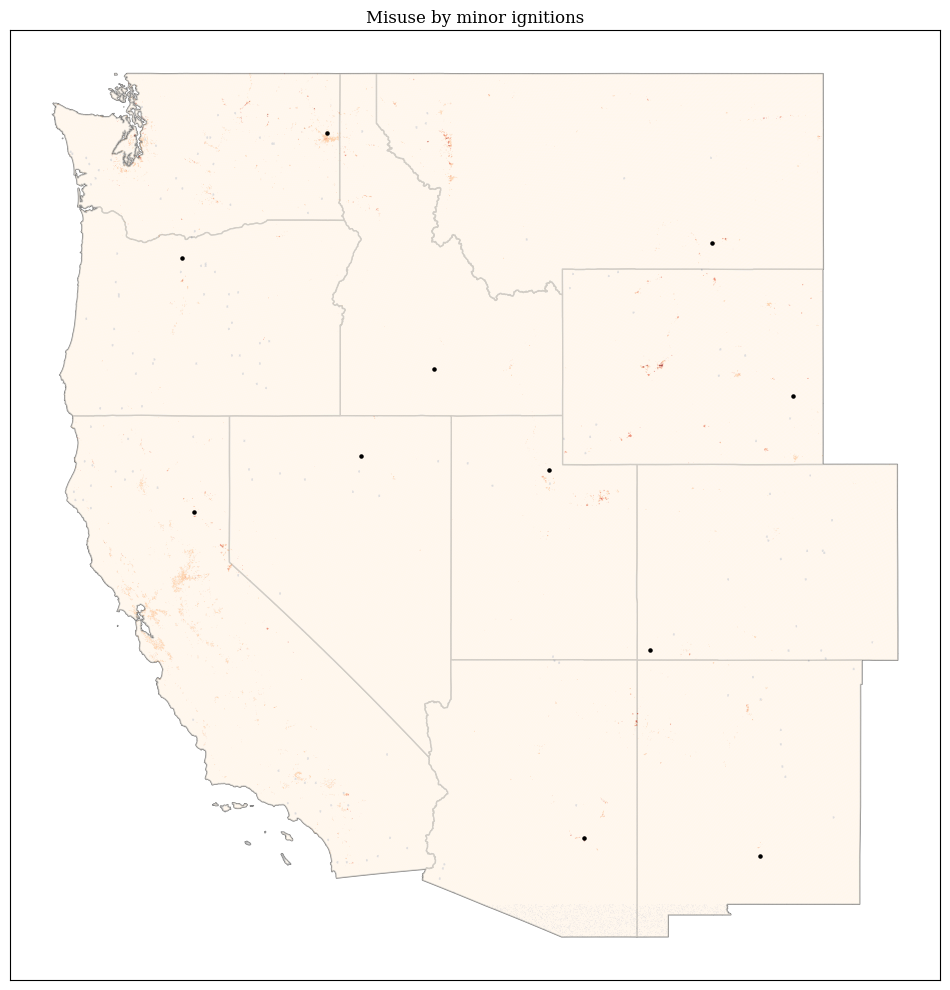

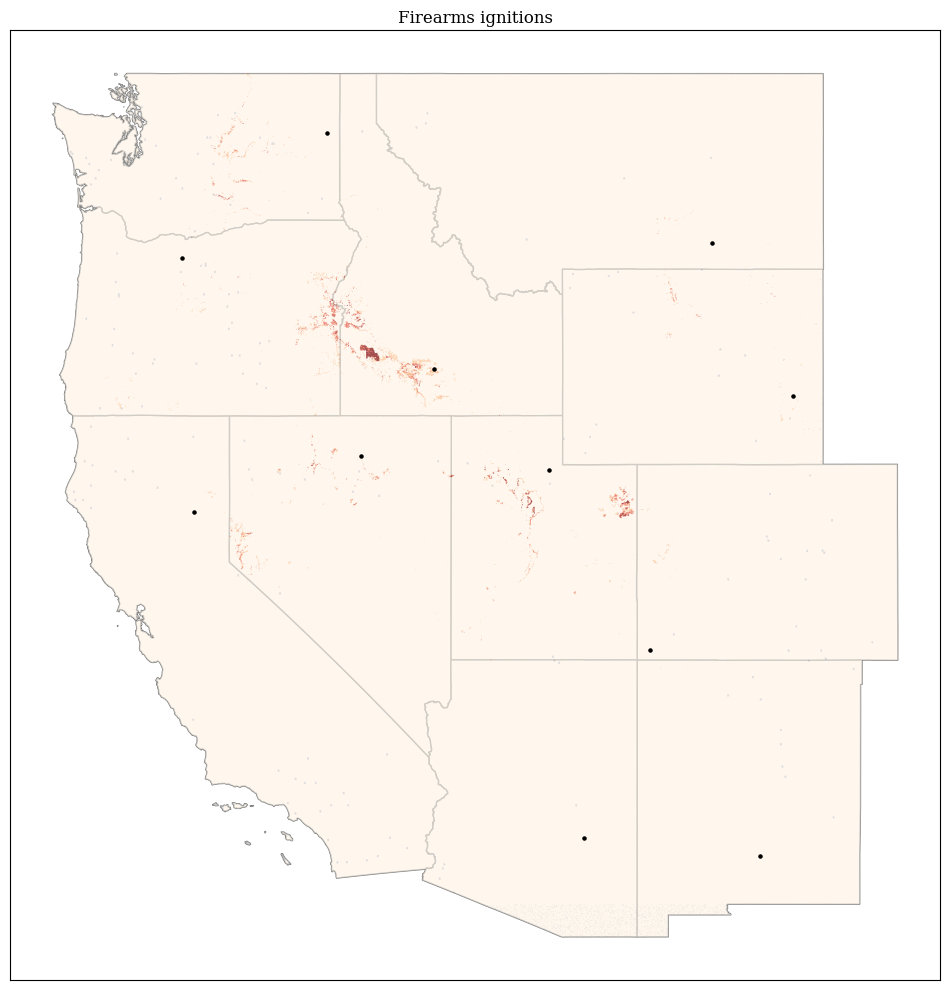

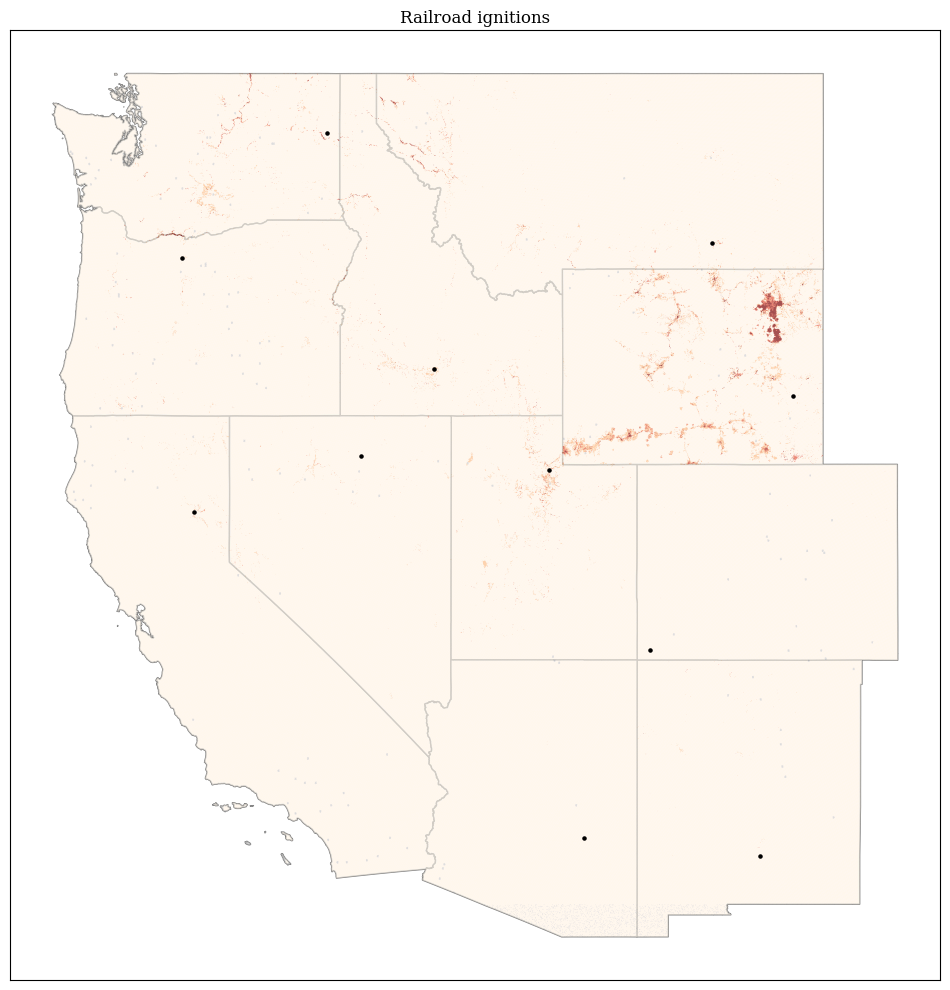

In [8]:
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman'] + plt.rcParams['font.serif']

causes =  ['Natural', 'Debris', 'Fireworks', 'Arson', 'Recreation', 'Smoking',
           'Equipment', 'Power', 'Misuse by minor', 'Firearms', 'Railroad']
report_df = pd.DataFrame(columns=['Ignition', 'Low (%)', 'Medium (%)', 'High (%)', 'Very high (%)', 'NA (%)'])
for i, cause in enumerate(iterable=causes):
    print('\n',i+1,': Processing for', cause, 'ignition source...')
    igni = joblib.load(filename=f'/bsuhome/yavarpourmohamad/scratch/Dissertation/Cause_specific/modeling/Final_models/{cause}_Ignition.pkl')
   
    y_igni_prob = igni.predict_proba(map_cln[map_cln.columns[3:]])

    prob_igni = pd.DataFrame(data = y_igni_prob, columns = ['No_fire', 'Fire'])

    map_dt = map_cln.copy(deep = True)
    map_dt['Fire'] = prob_igni['Fire'].to_numpy()
    # Adding fire points
    pnt_fire = selected_fires.copy(deep=True)
    pnt_fire = gpd.GeoDataFrame(data=pnt_fire,
                                crs='EPSG:4326',
                                geometry=gpd.points_from_xy(x=pnt_fire.LONGITUDE,
                                                            y=pnt_fire.LATITUDE))
    fire_days = dict()
    grid_days = dict()
    fig, axs = plt.subplots(nrows=1, ncols=1, sharey=False, figsize = (12, 30))
    doy = 186
    j = 0
    temp_grd = map_dt[map_dt['DISCOVERY_DOY'] == doy]
    temp_grd = pd.merge(left = grid, right = temp_grd, left_on = 'FID', right_on = 'index', how = 'left')

    na = ((len(temp_grd[temp_grd['Fire'] <= 0.25]) + len(temp_grd[(temp_grd['Fire'] > 0.25) & (temp_grd['Fire'] <= 0.5)]) + len(temp_grd[(temp_grd['Fire'] > 0.5) & (temp_grd['Fire'] <= 0.75)]) + len(temp_grd[temp_grd['Fire'] > 0.75])) * 100) / len(temp_grd)
    report = pd.DataFrame(data={'Ignition': [cause],
                                'Low (%)': [(len(temp_grd[temp_grd['Fire'] <= 0.25]) *100) / len(temp_grd)],
                                'Medium (%)': [(len(temp_grd[(temp_grd['Fire'] > 0.25) & (temp_grd['Fire'] <= 0.5)]) * 100) / len(temp_grd)],
                                'High (%)': [(len(temp_grd[(temp_grd['Fire'] > 0.5) & (temp_grd['Fire'] <= 0.75)]) * 100) / len(temp_grd)],
                                'Very high (%)': [(len(temp_grd[temp_grd['Fire'] > 0.75]) * 100) / len(temp_grd)],
                                'NA (%)': [100-na]
                                })
    report_df = pd.concat([report_df, report], ignore_index=True)

    # Ignition probability map plots section
    states.plot(ax = axs, edgecolor = 'grey', color = 'white')
    temp_grd.plot(column='Fire',
                  cmap='OrRd',
                  ax=axs,
                  legend=False,
                  missing_kwds={'color': 'lightgrey'},
                  scheme='equal_interval', # 'quantiles'
                  k=4)
    axs.tick_params(axis = 'both', which = 'both', length = 0)
    axs.set_xticklabels([])
    axs.set_yticklabels([])
    axs.set_title(f'{cause} ignitions')

    pnt_fire.plot(ax=axs, color='k', markersize=5)
    

In [9]:
report_df

,Ignition,Low (%),Medium (%),High (%),Very high (%),NA (%)
0,Natural,31.871658,18.509869,22.860121,26.586616,0.171736
1,Debris,94.367039,3.518555,1.490098,0.452572,0.171736
2,Fireworks,77.027986,10.533326,6.176515,6.090436,0.171736
3,Arson,98.222474,1.180363,0.377014,0.048413,0.171736
4,Recreation,96.448163,2.823040,0.506505,0.050556,0.171736
5,Smoking,97.173648,1.605725,0.692463,0.356427,0.171736
6,Equipment,90.224240,6.936647,1.663555,1.003822,0.171736
7,Power,99.810665,0.017566,0.000032,0.000000,0.171736
8,Misuse by minor,99.511710,0.289668,0.024320,0.002565,0.171736
9,Firearms,99.435795,0.237456,0.119296,0.035717,0.171736
